<a href="https://colab.research.google.com/github/pscabral/IFMASOFTEX_1/blob/main/Yolo8_v1.7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install mega.py

from mega import Mega

# Crie uma instância da classe Mega
mega = Mega()

# Cole o link completo do Mega.nz (incluindo a chave)
url = "https://mega.nz/file/IutEjTyL#1SKwDXDjvmyvHjl7GxRM9kx2blr12R_5utVac9FU-LU"

# Use o link completo para fazer o download
mega.download_url(url)

!unzip w251final.v2i.yolov8.zip

In [ ]:
!pip install ultralytics

In [ ]:
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='darkgrid')
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image

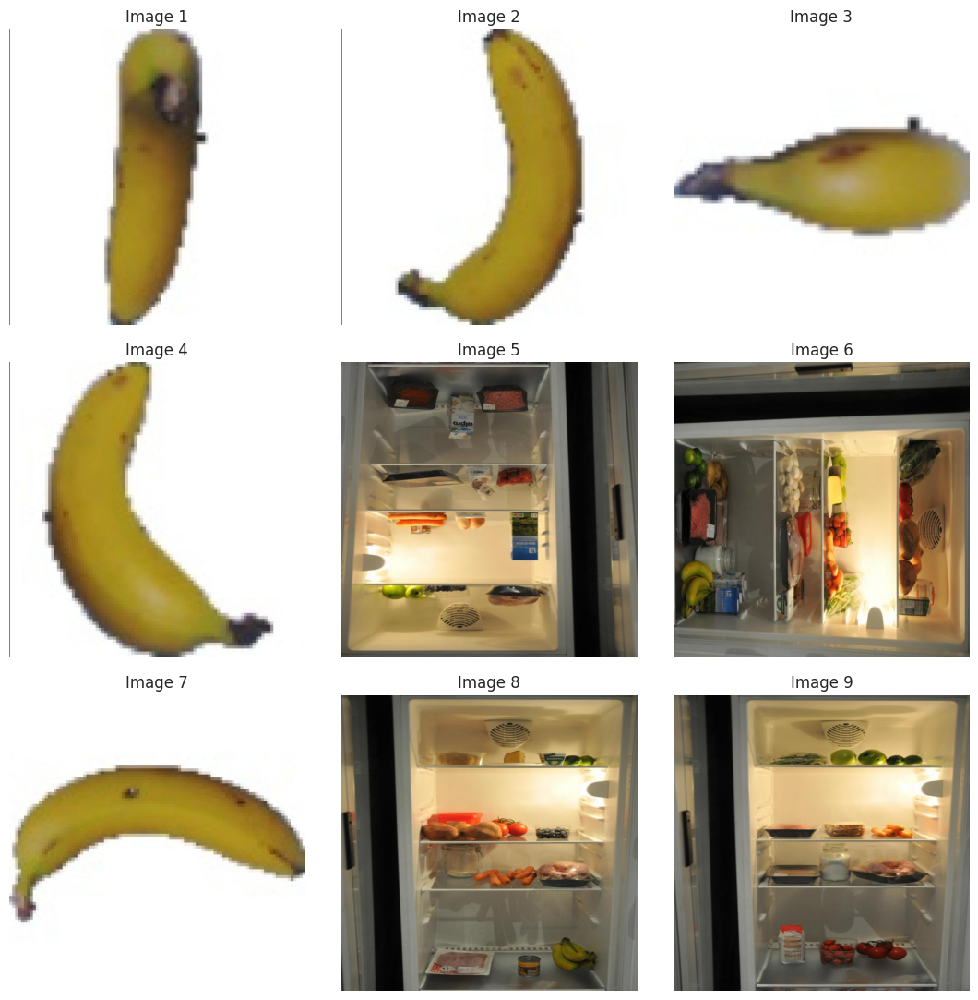

In [ ]:
Image_dir = '/content/w251final.v2i/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
image = cv2.imread("/content/w251final.v2i/train/images/104_100_jpg.rf.27d8395e119e884e298243464aad67ec.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 640x640 and 3 channels.



image 1/1 /content/w251final.v2i/train/images/104_100_jpg.rf.27d8395e119e884e298243464aad67ec.jpg: 640x640 (no detections), 104.9ms
Speed: 2.7ms preprocess, 104.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


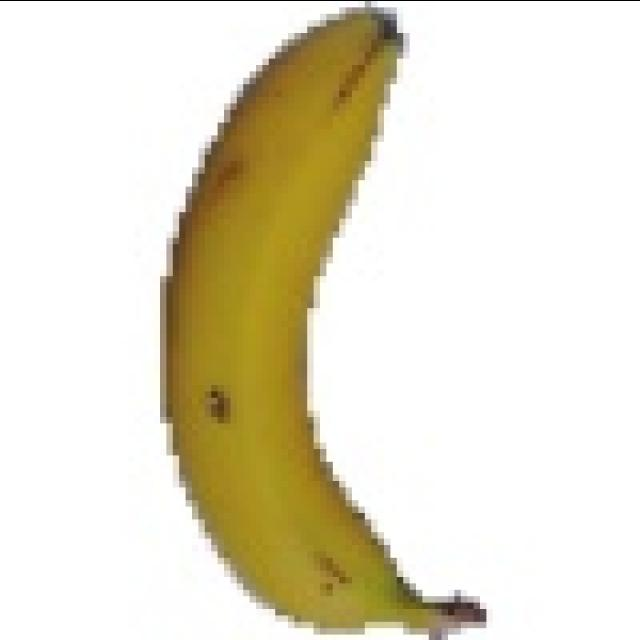

In [ ]:
model = YOLO("yolov8n.pt")

# Use the model to detect object
image = "/content/w251final.v2i/train/images/104_100_jpg.rf.27d8395e119e884e298243464aad67ec.jpg"
result_predict = model.predict(source = image, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [ ]:
pip install -U albumentations

In [ ]:
import albumentations as A
import cv2

# Declare an augmentation pipeline
transform = A.Compose([
    A.RandomCrop(width=256, height=256),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread("/content/w251final.v2i/train/images/104_100_jpg.rf.27d8395e119e884e298243464aad67ec.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]

In [ ]:
Final_model = YOLO('yolov8n.pt')
Result_Final_model = Final_model.train(data="/content/w251final.v2i/data.yaml", epochs=20, imgsz=640, batch=64, lr0=0.0001, dropout=0.15, device='cpu')


Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/w251final.v2i/data.yaml, epochs=20, time=None, patience=50, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.15, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line

100%|██████████| 755k/755k [00:00<00:00, 33.9MB/s]


Overriding model.yaml nc=80 with nc=31

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

train: Scanning /content/w251final.v2i/train/labels... 1967 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1967/1967 [00:01<00:00, 1396.25it/s]


train: New cache created: /content/w251final.v2i/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/w251final.v2i/valid/labels... 204 images, 0 backgrounds, 0 corrupt: 100%|██████████| 204/204 [00:00<00:00, 1479.04it/s]

val: New cache created: /content/w251final.v2i/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000286, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      1.309      4.457      1.249        545        640: 100%|██████████| 31/31 [09:11<00:00, 17.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.04s/it]

                   all        204       1369    0.00211     0.0217     0.0175      0.015



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      1.117      3.058      1.127        442        640: 100%|██████████| 31/31 [09:10<00:00, 17.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.31s/it]

                   all        204       1369      0.056      0.652      0.203      0.141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20         0G      1.059      2.004      1.119        624        640: 100%|██████████| 31/31 [09:08<00:00, 17.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.36s/it]

                   all        204       1369      0.554       0.37      0.527      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20         0G      1.023      1.427      1.111        408        640: 100%|██████████| 31/31 [09:06<00:00, 17.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.17s/it]

                   all        204       1369      0.814      0.564       0.76      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20         0G      0.988      1.184      1.088        575        640: 100%|██████████| 31/31 [09:10<00:00, 17.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.69s/it]

                   all        204       1369      0.789      0.782      0.838      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         0G     0.9508      1.019       1.07        530        640: 100%|██████████| 31/31 [09:05<00:00, 17.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.37s/it]

                   all        204       1369      0.819      0.783      0.855      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G      0.931     0.9566      1.061        485        640: 100%|██████████| 31/31 [09:04<00:00, 17.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.62s/it]

                   all        204       1369       0.85      0.855      0.914       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20         0G     0.9098     0.9016      1.053        410        640: 100%|██████████| 31/31 [09:04<00:00, 17.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.73s/it]

                   all        204       1369      0.886      0.888      0.934      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G     0.9188     0.8583      1.042        662        640: 100%|██████████| 31/31 [09:09<00:00, 17.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.31s/it]

                   all        204       1369       0.91        0.9      0.949      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G     0.9069     0.8337      1.039        481        640: 100%|██████████| 31/31 [09:07<00:00, 17.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.67s/it]

                   all        204       1369      0.895       0.91      0.947      0.654


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20         0G     0.9418     0.8618      1.076        256        640: 100%|██████████| 31/31 [08:53<00:00, 17.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.42s/it]

                   all        204       1369      0.854      0.901      0.925      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G     0.9168     0.7857      1.063        296        640: 100%|██████████| 31/31 [08:46<00:00, 17.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.38s/it]

                   all        204       1369        0.9      0.909      0.948      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G     0.9044     0.7698      1.058        237        640: 100%|██████████| 31/31 [08:49<00:00, 17.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.30s/it]

                   all        204       1369      0.891      0.944      0.952      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G     0.8944     0.7386      1.046        326        640: 100%|██████████| 31/31 [08:53<00:00, 17.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.64s/it]

                   all        204       1369      0.904      0.916      0.951      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G     0.8818     0.7168      1.046        344        640: 100%|██████████| 31/31 [08:55<00:00, 17.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.44s/it]

                   all        204       1369       0.93       0.93      0.961      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G     0.8704     0.7027      1.043        364        640: 100%|██████████| 31/31 [08:49<00:00, 17.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.23s/it]

                   all        204       1369      0.915      0.939      0.961      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G     0.8582     0.6805      1.037        328        640: 100%|██████████| 31/31 [08:47<00:00, 17.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.34s/it]

                   all        204       1369      0.929      0.943      0.965      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G     0.8555     0.6687       1.03        305        640: 100%|██████████| 31/31 [08:46<00:00, 16.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.57s/it]

                   all        204       1369      0.937      0.925      0.962      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G     0.8471     0.6611      1.026        322        640: 100%|██████████| 31/31 [08:48<00:00, 17.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.46s/it]

                   all        204       1369      0.915      0.955      0.965      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G     0.8398     0.6503      1.021        336        640: 100%|██████████| 31/31 [08:49<00:00, 17.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.32s/it]

                   all        204       1369      0.945      0.952      0.969      0.707



20 epochs completed in 3.102 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3011693 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.10s/it]


                   all        204       1369      0.947       0.95      0.969      0.707
                 apple        204         36       0.97      0.944      0.963      0.747
                banana        204        144      0.993          1      0.995      0.946
                  beef        204         30      0.813      0.733      0.844      0.476
           blueberries        204         38      0.996      0.974      0.976      0.588
                 bread        204         30      0.995      0.933       0.99      0.725
                butter        204         38      0.989          1      0.995       0.83
              capsicum        204          4          1      0.992      0.995      0.717
                carrot        204         42      0.973      0.881       0.98      0.745
                cheese        204         55          1      0.936      0.991      0.762
               chicken        204         43          1      0.998      0.995      0.746
        chicken_breas

In [ ]:
print('result of training')
tpaths2=[]
for dirname, _, filenames in os.walk('/content/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.png' or filename[-4:]=='.jpg':
            tpaths2+=[(os.path.join(dirname, filename))]
tpaths2=sorted(tpaths2)
print(tpaths2[0])

result of training
/content/runs/detect/train/F1_curve.png


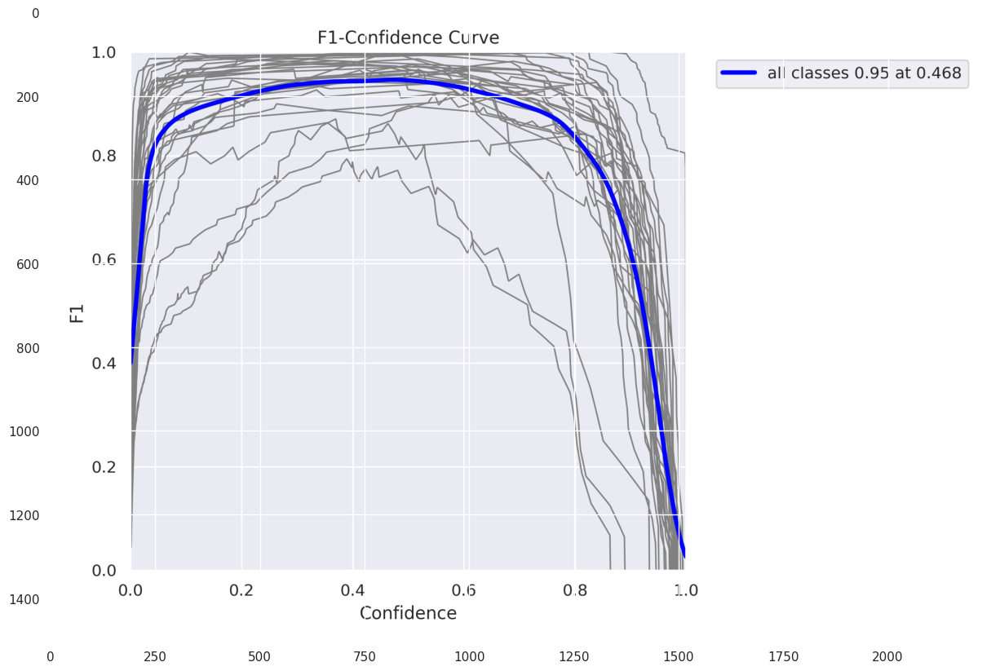

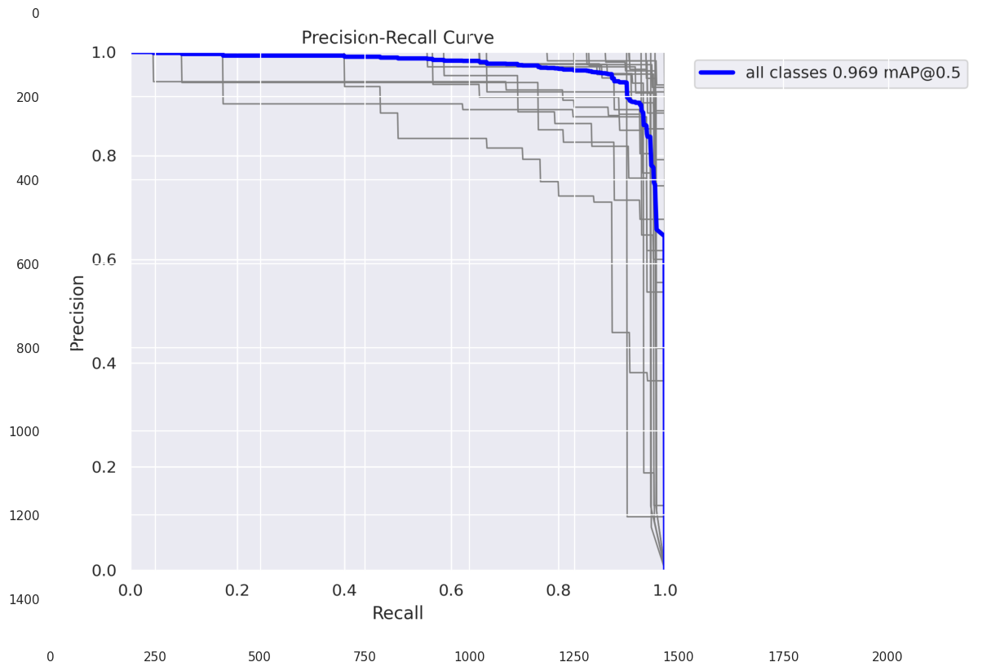

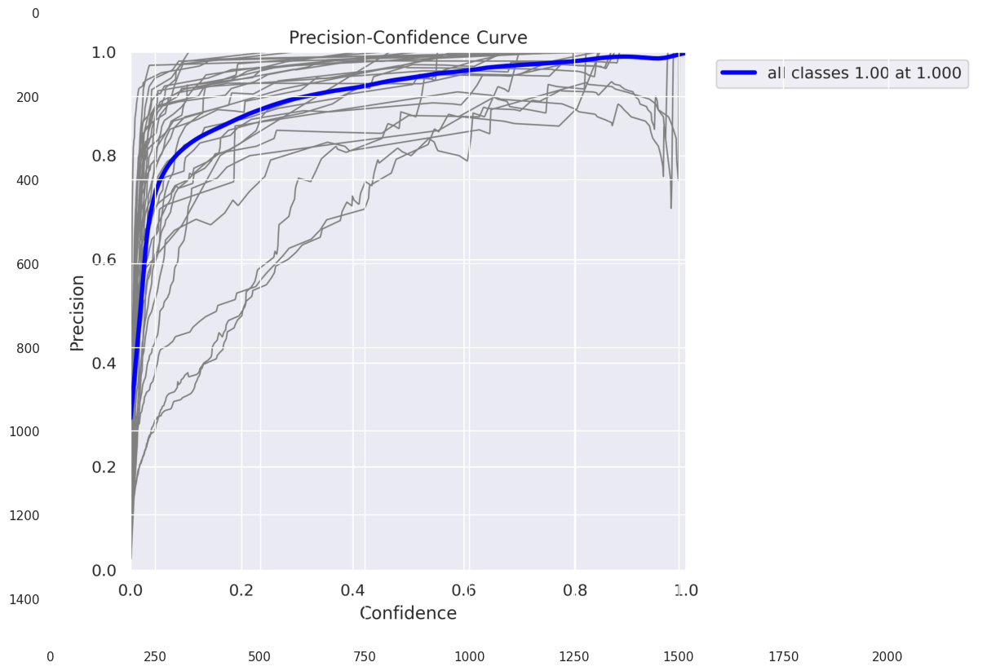

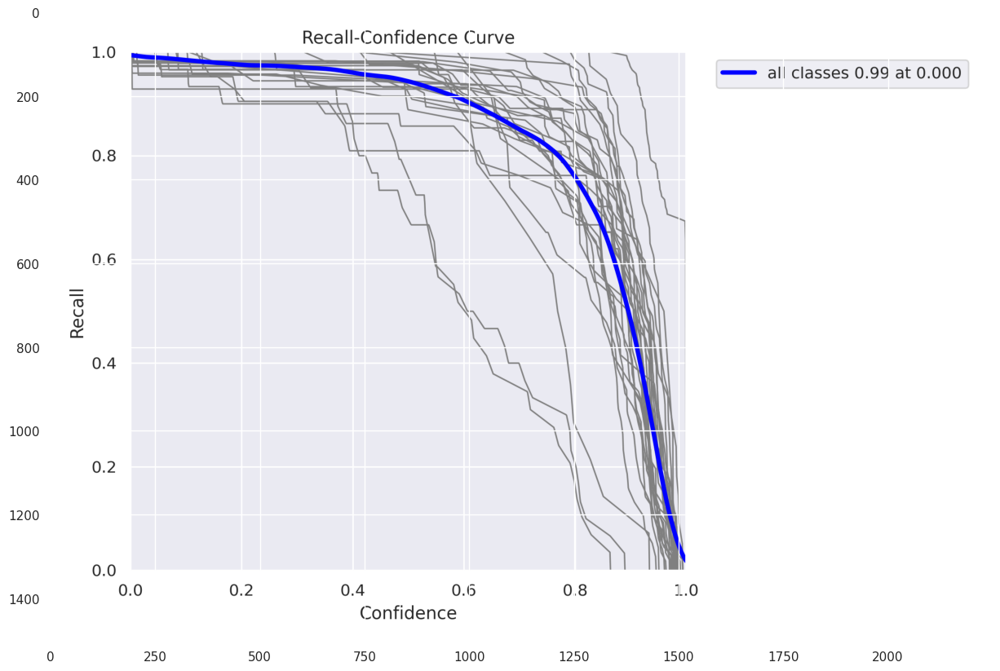

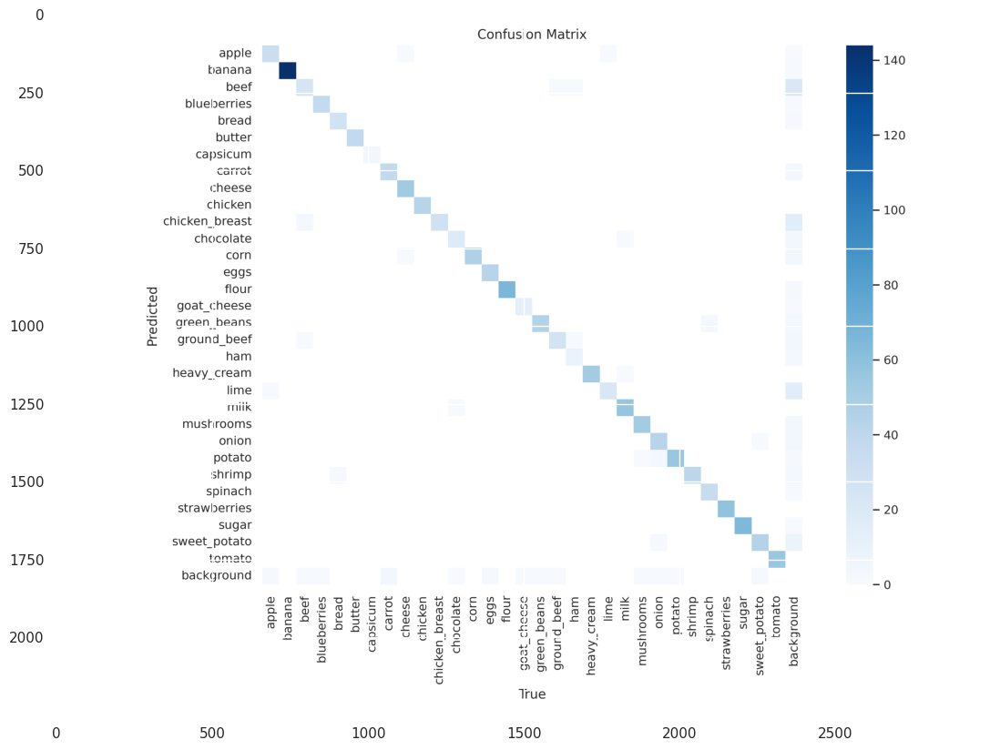

...

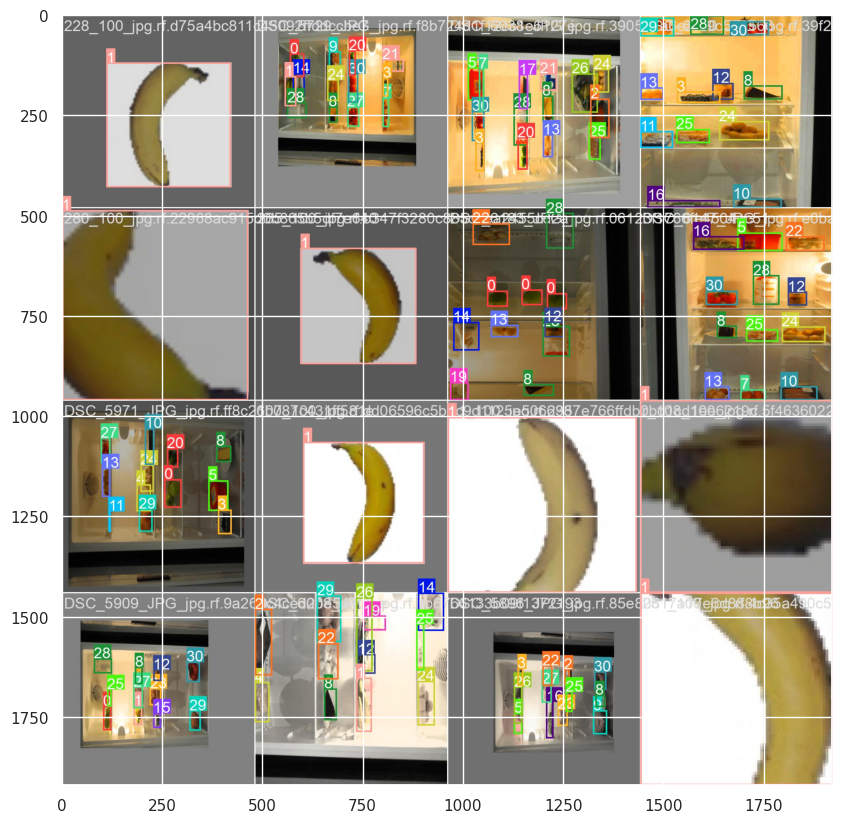

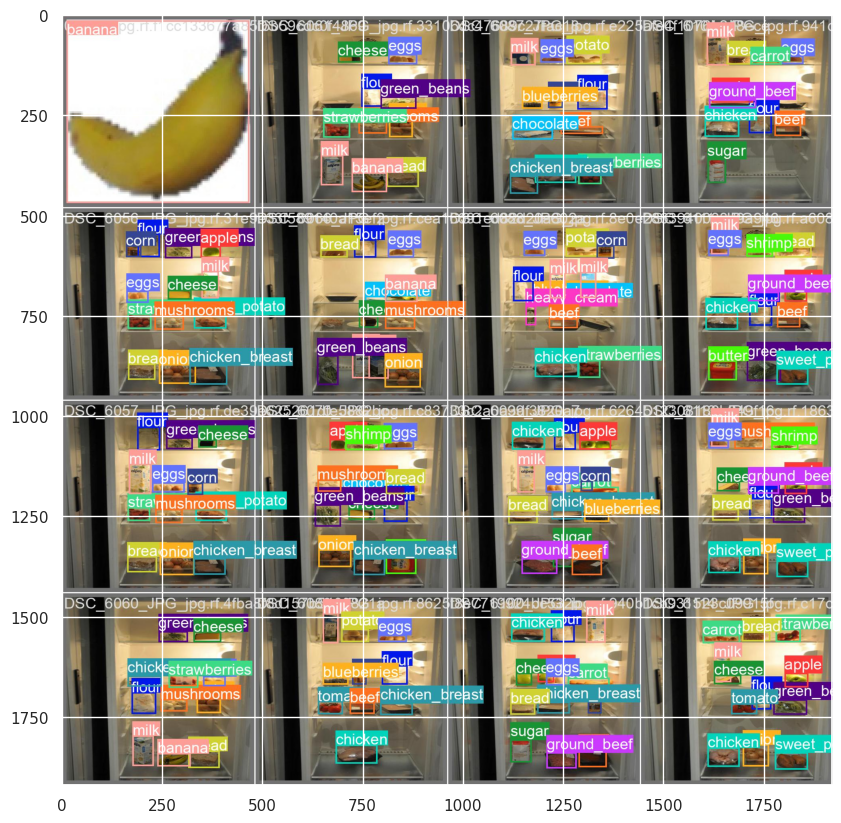

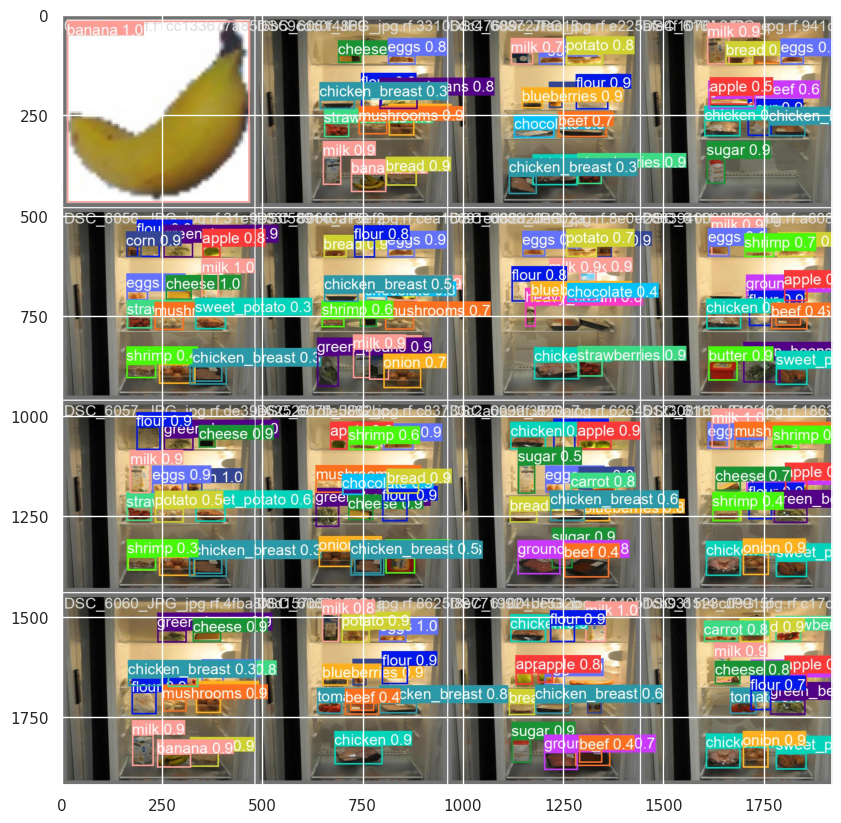

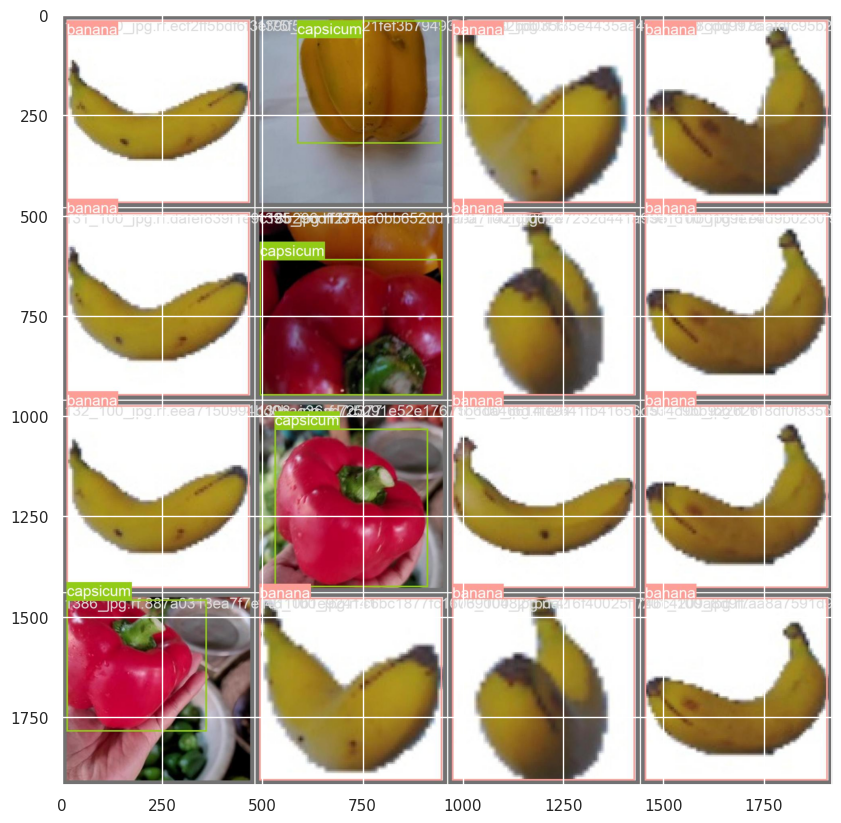

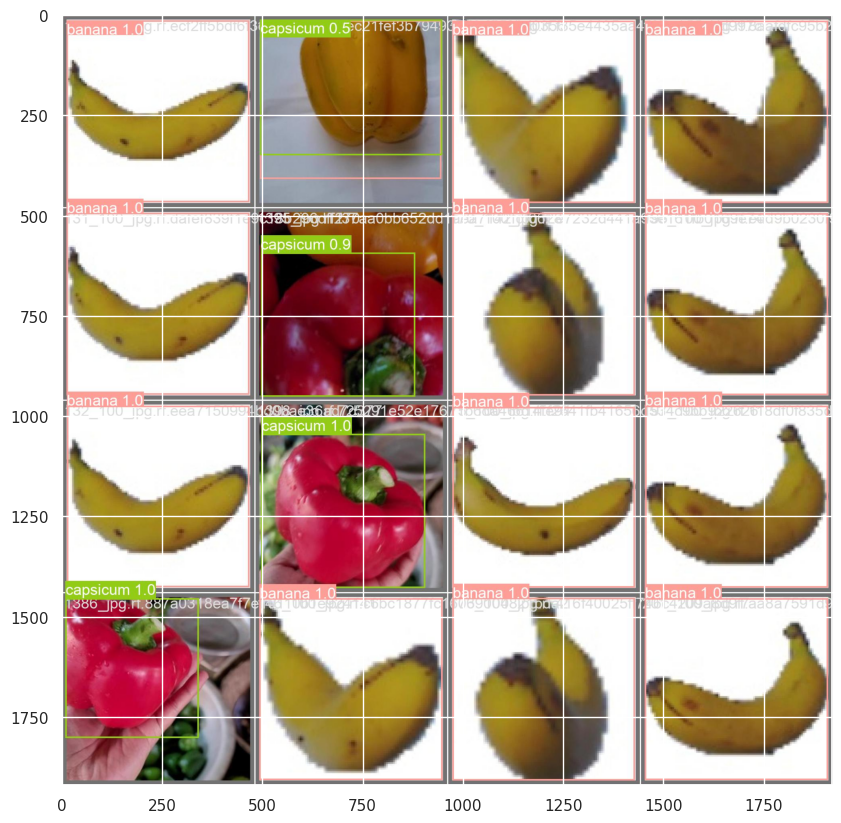

In [ ]:
for path in tpaths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

In [ ]:
print('Predict')
best_path0='/content/runs/detect/train/weights/best.pt'
source0='/content/w251final.v2i/valid/images'

Predict


In [ ]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])

/content/w251final.v2i/valid/images/0_100_jpg.rf.f1cc133677a85f6b59cdc0f4869e68bd.jpg


In [ ]:
model2 = YOLO(best_path0)
print('yolo task=detect mode=predict')

yolo task=detect mode=predict


In [ ]:
!yolo task=detect mode=predict model={best_path0} conf=0.4 source={source0}

In [ ]:
print('Result of Prediction')
results = model2.predict(source0,conf=0.4)
print(len(results))

Result of Prediction

image 1/204 /content/w251final.v2i/valid/images/0_100_jpg.rf.f1cc133677a85f6b59cdc0f4869e68bd.jpg: 640x640 1 banana, 118.1ms
image 2/204 /content/w251final.v2i/valid/images/121_100_jpg.rf.ecf2ff5bdf6f3ef75f5d4c747e393d44.jpg: 640x640 1 banana, 69.4ms
image 3/204 /content/w251final.v2i/valid/images/131_100_jpg.rf.dafef839f1e9c18b296dff270ce058bf.jpg: 640x640 1 banana, 72.0ms
image 4/204 /content/w251final.v2i/valid/images/132_100_jpg.rf.eea7150994bd0bae36ad7d377499030f.jpg: 640x640 1 banana, 75.1ms
image 5/204 /content/w251final.v2i/valid/images/1386_jpg.rf.887a0318ea7f7e10110b1e92414120e1.jpg: 640x640 1 capsicum, 70.1ms
image 6/204 /content/w251final.v2i/valid/images/1390_jpg.rf.9ec21fef3b794939a6d382bd0356dc8a.jpg: 640x640 1 capsicum, 71.6ms
image 7/204 /content/w251final.v2i/valid/images/1395_jpg.rf.f37aa0bb652dd1aea7142fdf06284c93.jpg: 640x640 1 capsicum, 75.0ms
image 8/204 /content/w251final.v2i/valid/images/1398_jpg.rf.725291e52e17671b6da46614fe94bf76.jpg: 64

In [ ]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,0.000000,0.044128,640.000000,640.000000,0.994471,1.0,0_100_jpg.rf.f1cc133677a85f6b59cdc0f4869e68bd.jpg,0.0
0,0.093628,0.548706,640.000000,640.000000,0.991044,1.0,121_100_jpg.rf.ecf2ff5bdf6f3ef75f5d4c747e393d4...,1.0
0,0.187378,0.490906,640.000000,640.000000,0.994412,1.0,131_100_jpg.rf.dafef839f1e9c18b296dff270ce058b...,2.0
0,0.008545,0.000000,640.000000,640.000000,0.993976,1.0,132_100_jpg.rf.eea7150994bd0bae36ad7d377499030...,3.0
0,0.128662,0.000000,461.891418,488.990356,0.965407,6.0,1386_jpg.rf.887a0318ea7f7e10110b1e92414120e1.jpg,4.0
...,...,...,...,...,...,...,...,...
0,0.430542,0.000000,640.000000,639.803955,0.995191,1.0,r_4_100_jpg.rf.6fb1b8597e18204c21f4e6c9350e808...,199.0
0,0.000000,0.000000,640.000000,639.848877,0.995429,1.0,r_64_100_jpg.rf.22ba0ca3e161de4b3cfb962e8a071b...,200.0
0,0.363647,0.000000,640.000000,640.000000,0.994132,1.0,r_81_100_jpg.rf.abe88d5594dccef7cfebe689e9143e...,201.0
0,0.175476,0.000000,639.587036,640.000000,0.994035,1.0,r_85_100_jpg.rf.4db3ac8ab98ffeab0b15e28ce6b6b9...,202.0


In [ ]:
class_map = {
    0: 'apple',
    1: 'banana',
    2: 'beef',
    3: 'blueberries',
    4: 'bread',
    5: 'butter',
    6: 'capsicum',
    7: 'carrot',
    8: 'cheese',
    9: 'chicken',
    10: 'chicken_breast',
    11: 'chocolate',
    12: 'corn',
    13: 'eggs',
    14: 'flour',
    15: 'goat_cheese',
    16: 'green_beans',
    17: 'ground_beef',
    18: 'ham',
    19: 'heavy_cream',
    20: 'lime',
    21: 'milk',
    22: 'mushrooms',
    23: 'onion',
    24: 'potato',
    25: 'shrimp',
    26: 'spinach',
    27: 'strawberries',
    28: 'sugar',
    29: 'sweet_potato',
    30: 'tomato'
}

In [ ]:
PBOX['class'] = PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX = PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,0.000000,0.044128,640.000000,640.000000,0.994471,banana,0_100_jpg.rf.f1cc133677a85f6b59cdc0f4869e68bd.jpg,0.0
1,0.093628,0.548706,640.000000,640.000000,0.991044,banana,121_100_jpg.rf.ecf2ff5bdf6f3ef75f5d4c747e393d4...,1.0
2,0.187378,0.490906,640.000000,640.000000,0.994412,banana,131_100_jpg.rf.dafef839f1e9c18b296dff270ce058b...,2.0
3,0.008545,0.000000,640.000000,640.000000,0.993976,banana,132_100_jpg.rf.eea7150994bd0bae36ad7d377499030...,3.0
4,0.128662,0.000000,461.891418,488.990356,0.965407,capsicum,1386_jpg.rf.887a0318ea7f7e10110b1e92414120e1.jpg,4.0
...,...,...,...,...,...,...,...,...
1380,0.430542,0.000000,640.000000,639.803955,0.995191,banana,r_4_100_jpg.rf.6fb1b8597e18204c21f4e6c9350e808...,199.0
1381,0.000000,0.000000,640.000000,639.848877,0.995429,banana,r_64_100_jpg.rf.22ba0ca3e161de4b3cfb962e8a071b...,200.0
1382,0.363647,0.000000,640.000000,640.000000,0.994132,banana,r_81_100_jpg.rf.abe88d5594dccef7cfebe689e9143e...,201.0
1383,0.175476,0.000000,639.587036,640.000000,0.994035,banana,r_85_100_jpg.rf.4db3ac8ab98ffeab0b15e28ce6b6b9...,202.0


banana            145
flour              68
sugar              65
strawberries       58
milk               58
potato             58
tomato             56
heavy_cream        56
mushrooms          54
corn               52
green_beans        51
cheese             51
onion              49
sweet_potato       48
chicken            43
eggs               42
shrimp             42
butter             38
carrot             38
blueberries        37
chicken_breast     34
spinach            34
ground_beef        33
apple              33
beef               32
lime               30
bread              29
chocolate          22
goat_cheese        13
ham                12
capsicum            4
Name: class, dtype: int64

In [ ]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2'])
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            cv2.putText(image, f'{label}', (x, int(y-4)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [ ]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {20+i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [ ]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

  0%|          | 0/204 [00:00<?, ?it/s]

In [ ]:
create_animation(images2)